<a href="https://colab.research.google.com/github/lamb-does-code/dog-breeds-classification/blob/main/dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Classifying dog breeds using Transfer Learning and Tensorflow**

>Dogs are amazing. 

In this project we're going to be using machine learning to help us identify different breeds of dogs.

To do this, we'll be using data from the [Kaggle dog breed identification competition](https://www.kaggle.com/c/dog-breed-identification/overview). It consists of a collection of 10,000+ labelled images of 120 different dog breeds (that means we'll be dealing with unstructured data).

This kind of problem is called 'multi-class' image classification. It's multi-class because we're trying to classify multiple different breeds of dog.

We're going to get through the following workflow:

1. Prepare the data (preprocessing, the 3 sets, X & y)
2. Choose and fit/train a model ([TensorFlow Hub](https:www.tensorflow.org/hub), tf.keras.applications, [TensorBoard](https://www.tensorflow.org/tensorboard), [EarlyStopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping)).
3. Evaluating a model (making predictions, comparing them with the ground truth labels).
4. Improve the model through experimentation (starting with a sample of images and slowly increase the number)
5. Save our model

In [1]:
import tensorflow as tf
import tensorflow_hub as hub
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from matplotlib.pyplot import imread
from IPython.display import display, Image
import os
import datetime

# Checking tensorflow version
print("TF version:", tf.__version__)
# Checking for GPU availability
print("GPU", "available (nice)" if tf.config.list_physical_devices("GPU") else "nope :(")

TF version: 2.4.1
GPU available (nice)


## 1. Getting our data ready

**Accessing the data**


In [2]:
labels_csv = pd.read_csv("drive/MyDrive/Datasets/dog_vision/labels.csv")
labels_csv.describe()

,id,breed
count,10222,10222
unique,10222,120
top,9d2451f69ee64a6d605739f98cb627d7,scottish_deerhound
freq,1,126


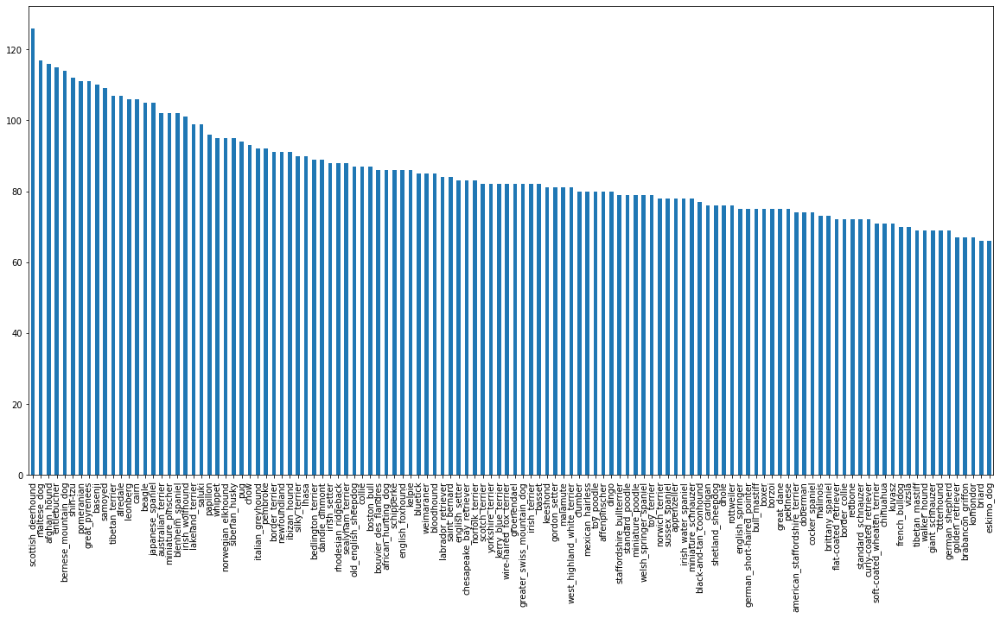

In [3]:
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10));

In [5]:
# Create pathnames from image ID's
filenames = ["/content/drive/MyDrive/Datasets/dog_vision/train/" + fname + ".jpg" for fname in labels_csv["id"]]
# Check whether number of filenames matches number of actual image files
# To avoid possible occurred problems while unzipping the file
if len(os.listdir("/content/drive/MyDrive/Datasets/dog_vision/train/")) == len(filenames):
  print("Filenames match actual amount of files!")
else:
  print("Filenames do not match actual amount of files, check the target directory.")

Filenames match actual amount of files!


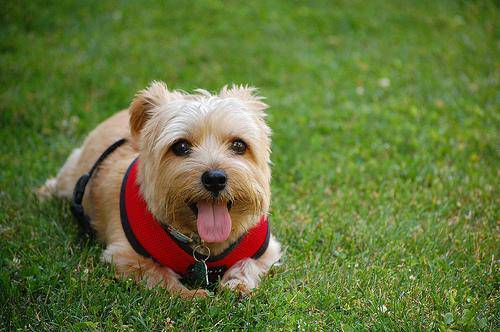

In [6]:
Image(filenames[14]) 

We'll take the labels from labels_csv and turn them into a NumPy array.

In [7]:
labels = labels_csv["breed"].to_numpy() # convert labels column to NumPy array
# See if number of labels matches the number of filenames (checking for missing data)
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


But we're not done yet. A machine learning model can't work with strings (which is what our labels actually are) so we have to convert it to numbers.

Let's first find our unique dog breeds, then we'll compare our labels to the unique breeds. This way we can create a list of booleans indicating which one is a real label (True)

In [8]:
unique_breeds = np.unique(labels)
print(f'There are a total of {len(unique_breeds)} unique breeds\n')

# Turn every label into a boolean array
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:1] # That's just for one

There are a total of 120 unique breeds



[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False])]

**Our own Validation set**

What's a validation set? It's a split of the data we can test our model on before making final predicitons on the test set. So let's make it.

P.S. Don't forget we're going to work with thousands and thousands of images, before training our model on so much data, it might be wise to first train it on a smaller sample of it, to ensure everything's ok.

In [9]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}

X = filenames
y = boolean_labels

# Split them into training and validation using NUM_IMAGES 
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES], 
                                                  test_size=0.2,
                                                  random_state=42)


What's left to do? 
Still a lot.


**Preprocessing images**

Meaning we're going to turn them into tensors, that's because our images are still just file paths.

You may ask later why I'll resize the images to (224,224)... It's because this is the size of input our model (we'll see this soon) takes, an image which is (224, 224, 3).

In [10]:
IMG_SIZE = 224

def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in image file
  image = tf.io.read_file(image_path)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values (Normalizing)
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

**Creating Data batches**

You might ask what a data batch is. Well, Tensorflow loves working with batches, which are small portions of data (32 by default), that's because otherwise we would compute on 10000 images and that may cause an error.

So it's more efficient to let the model work on one batch at a time in the form (image, label)

In [11]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label


Now we've got a simple function to turn our image file path names and their associated labels into tuples (we can turn these into Tensors next), we'll create a function to make data batches.

Because we'll be dealing with 3 different sets of data (training, validation and test), we'll make sure the function can accomodate for each set.

In [12]:
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (test data doesn't have labels, that's why y = None).
  """
  # If the data is a test dataset, we don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  # If the data if a validation dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels
    
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [13]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [14]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

Although, having data in batches might be a difficult concept, so let's try to visualize it

In [15]:
# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  plt.figure(figsize=(10, 10))
  for i in range(25):
     ax = plt.subplot(5, 5, i+1)   
     plt.imshow(images[i])
    # Add the image label as the title
     plt.title(unique_breeds[labels[i].argmax()])    
     plt.axis("off")

# To visualize a batch as image
# we also have to unwind it using as_numpy_iterator() so it becomes iterable



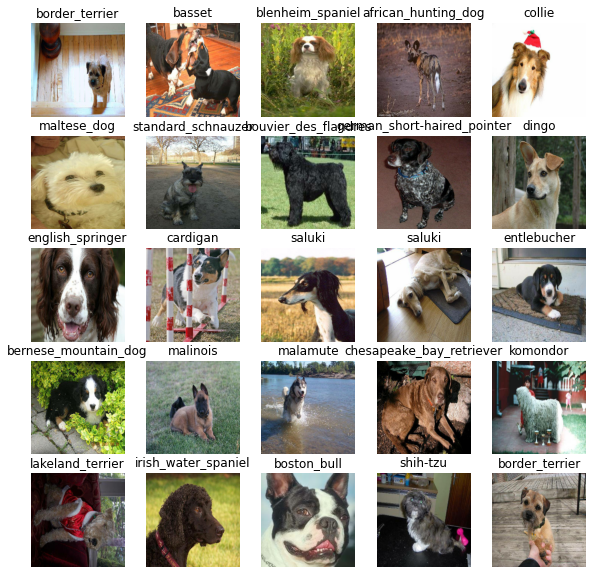

In [16]:
# Visualize training images from the training data batch
#Passing an iterable to next() will return the next item in the iterator.
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

And there they are

Now the first step is officially completed!

## 2. Choose and train a model

We will use Tensorflow Hub to choose a pretrained model. 

Why? 

Because building a machine learning model and training it from scratch can be expensive and time consuming.
Transfer learning helps eliviate some of these by taking what another model has learned and using that information with your own problem.

In [17]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

There are many ways of building a model in TensorFlow. To know what our model is doing under the hood that's the [place](https://towardsdatascience.com/review-mobilenetv2-light-weight-model-image-classification-8febb490e61c)

Knowing this, let's create a function which:

* Takes the input shape, output shape and the model we've chosen's URL as parameters.
* Defines the layers in a Keras model in a sequential fashion (do this first, then this, then that).
* Compiles the model (says how it should be evaluated and improved).
* Builds the model (tells it what kind of input shape it'll be getting).
* Returns the model.

We'll take a look at the code first, then dicuss each part.

In [18]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # First layer (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE, 
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(), 
      metrics=["accuracy"] 
  )

  model.build(INPUT_SHAPE)
  
  return model



**Building the model**

We use model.build() whenever we're using a layer from TensorFlow Hub to tell our model what input shape it can expect.


In [19]:
# Create a model and check its details
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


**Creating Callbacks**

Callbacks are helper functions a model can use during training to do things such as save a models progress, check a models progress or stop training early if a model stops improving.

The two callbacks we're going to add are a TensorBoard callback and an Early Stopping callback.

*TensorBoard Callback*

TensorBoard helps provide a visual way to monitor the progress of your model during and after training.

It can be used directly in a notebook to track the performance measures of a model such as loss and accuracy.

To set up a TensorBoard callback and view TensorBoard in a notebook, we need to do three things:
* Load the TensorBoard notebook extension.
* Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's fit() function.
* Visualize the our models training logs using the %tensorboard magic function.

In [20]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [21]:
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/MyDrive/Dog vision/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

*Early Stopping Callback*

Early stopping helps prevent overfitting by stopping a model when a certain evaluation metric stops improving. If a model trains for too long, it can do so well at finding patterns in a certain dataset that it's not able to use those patterns on another dataset it hasn't seen before (doesn't generalize).

In [22]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of no improvements

**Training a model on a subset**

The model will first train on 1000 images to make sure it all works

The final parameter we'll define before training is NUM_EPOCHS (also known as number of epochs).

NUM_EPOCHS defines how many passes of the data we'd like our model to do. A pass is equivalent to our model trying to find patterns in each dog image and see which patterns relate to each label.

If NUM_EPOCHS=1, the model will only look at the data once and will probably score badly because it hasn't a chance to correct itself.

In [23]:
# Check again if GPU is available (otherwise computing will take a long time)
print("GPU", "available (nice)" if tf.config.list_physical_devices("GPU") else "nope :(")

GPU available (nice)


In [24]:
# How many rounds should we get the model to look through the data?
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [25]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """  
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard, early_stopping])
  
  return model

In [26]:
# Fit the model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 237s 8s/step - loss: 5.1681 - accuracy: 0.0487 - val_loss: 3.3037 - val_accuracy: 0.2450
Epoch 2/100
25/25 [==============================] - 4s 155ms/step - loss: 1.9027 - accuracy: 0.6342 - val_loss: 2.0663 - val_accuracy: 0.5150
Epoch 3/100
25/25 [==============================] - 4s 157ms/step - loss: 0.6225 - accuracy: 0.9245 - val_loss: 1.5792 - val_accuracy: 0.6300
Epoch 4/100
25/25 [==============================] - 4s 154ms/step - loss: 0.2602 - accuracy: 0.9914 - val_loss: 1.4281 - val_accuracy: 0.6450
Epoch 5/100
25/25 [==============================] - 4s 154ms/step - loss: 0.1636 - accuracy: 0.9934 - val_loss: 1.3494 - val_accuracy: 0.6750
Epoch 6/100
25/25 [==============================] - 4s 156ms/step - loss: 0.1017 - accuracy: 0.9997 - val_loss: 1.3023 - val_accuracy: 0.6750
Epoch 7/100
25/25 [==============================]

It looks like our model might be overfitting (getting far better results on the training set than the validation set)

**Checking TensorBoard logs**

In [27]:
%tensorboard --logdir drive/MyDrive/Dog\ vision/logs

<IPython.core.display.Javascript object>

**Making and evaluating predictions using a trained model**

In [28]:
# Make predictions on the validation data
predictions = model.predict(val_data, verbose=1) # verbose shows us how long there is to go
predictions

7/7 [==============================] - 1s 119ms/step


array([[1.4874748e-03, 3.7960006e-05, 1.5123746e-03, ..., 7.6776813e-04,
        1.4587996e-05, 6.1794748e-03],
       [3.7939209e-03, 1.4614008e-03, 1.7236995e-02, ..., 5.1661604e-04,
        5.3477508e-04, 4.3104930e-04],
       [2.8418768e-05, 2.3903322e-04, 1.3498958e-05, ..., 5.7434960e-04,
        1.2750104e-04, 3.8318807e-04],
       ...,
       [4.5412803e-06, 1.2251919e-05, 1.4334459e-04, ..., 2.5821044e-05,
        4.1346916e-04, 7.3704095e-06],
       [2.7150207e-03, 1.2536970e-04, 1.6279252e-03, ..., 5.4542057e-04,
        1.2661699e-04, 2.0003119e-02],
       [1.4070967e-04, 3.6516829e-04, 3.6405246e-03, ..., 9.1203498e-03,
        2.7230503e-03, 6.0508093e-05]], dtype=float32)

In this case, making predictions on the validation data (200 images) returns an array (predictions) of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

We want now to compare a prediction to its true label and original image.

In [29]:
# Turn prediction probabilities into their respective label
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'border_terrier'

Wonderful! Now we've got a list of all different predictions our model has made, we'll do the same for the validation images and validation labels.

Remember, the model hasn't trained on the validation data, during the fit() function, it only used the validation data to evaluate itself. So we can use the validation images to visually compare our models predictions with the validation labels.

Since our validation data (val_data) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using unbatch()) and then turn it into an iterator using as_numpy_iterator().

In [30]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)

Let's make some functions to make these all a bit more visualize.

More specifically, we want to be able to view an image, its predicted label and its actual label (true label).

In [31]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  
  # Get the pred label
  pred_label = get_pred_label(pred_prob)
  
  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making



In [32]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

Now we've got some functions to help us visualize our predictions and evaluate our model, let's check out a few

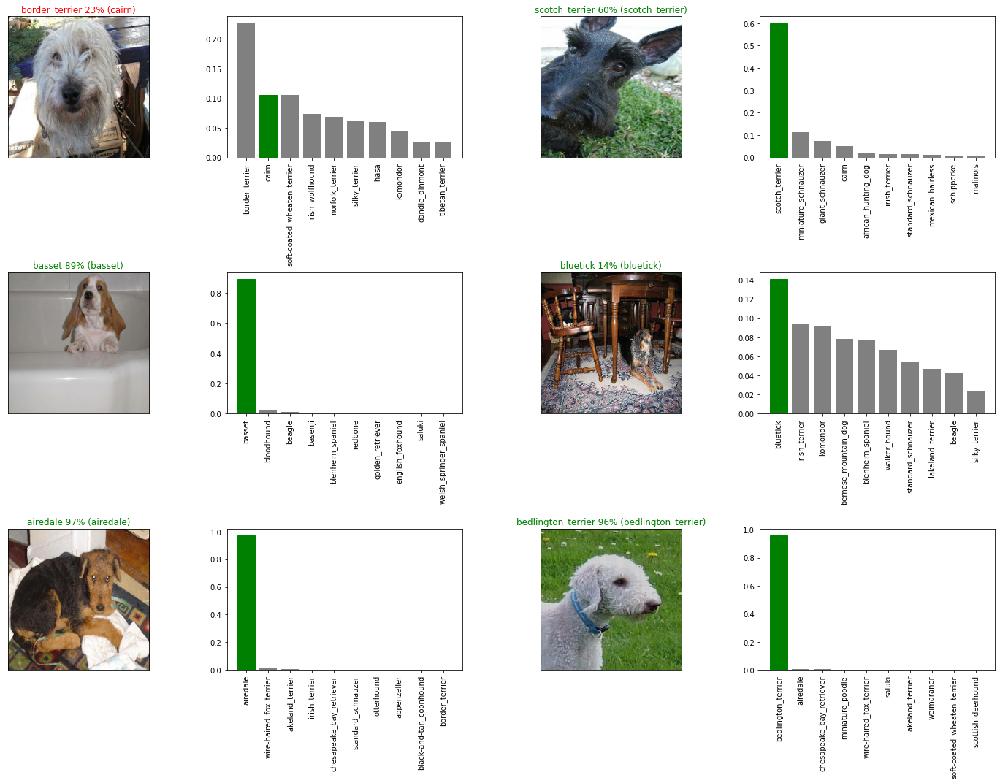

In [33]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

**Saving and reloading a model**

The format of an entire saved Keras model is h5. So we'll make a function which can take a model as input and utilise the save() method to save it as a h5 file to a specified directory.

In [34]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("/content/drive/MyDrive/Colab_Notebooks/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [35]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer}) # Telling we have a custom piece too
  return model

In [36]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: /content/drive/MyDrive/Colab_Notebooks/models/20210403-13261617456365-1000-images-Adam.h5...


'/content/drive/MyDrive/Colab_Notebooks/models/20210403-13261617456365-1000-images-Adam.h5'

In [38]:
# Load our model trained on 1000 images
model_1000_images = load_model('/content/drive/MyDrive/Colab_Notebooks/models/20210403-13261617456365-1000-images-Adam.h5')

Loading saved model from: /content/drive/MyDrive/Colab_Notebooks/models/20210403-13261617456365-1000-images-Adam.h5


In [39]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 110ms/step - loss: 1.2515 - accuracy: 0.6750


[1.2515395879745483, 0.675000011920929]

In [40]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

7/7 [==============================] - 1s 114ms/step - loss: 1.2515 - accuracy: 0.6750


[1.2515395879745483, 0.675000011920929]

Good, everything's working

### Training the model on the full data

We can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to X and all of the training labels to y. Let's check them out.

In [41]:
len(X), len(y)

(10222, 10222)

Before we can train a model on all these images, we'll have to turn them into a data batch.

In [42]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


In [43]:
# Instantiate a new model for training on the full dataset
model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


We'll need now Callbacks for this new model

In [44]:
# Create full model callbacks
# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [45]:
# Fit the full model to the full training data
model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

# Save model to file
save_model(model, suffix="Adam")

Epoch 1/100
320/320 [==============================] - 1899s 6s/step - loss: 2.4087 - accuracy: 0.4829
Epoch 2/100
320/320 [==============================] - 42s 131ms/step - loss: 0.3744 - accuracy: 0.8955
Epoch 3/100
320/320 [==============================] - 41s 127ms/step - loss: 0.2245 - accuracy: 0.9403
Epoch 4/100
320/320 [==============================] - 40s 126ms/step - loss: 0.1520 - accuracy: 0.9645
Epoch 5/100
320/320 [==============================] - 40s 125ms/step - loss: 0.0988 - accuracy: 0.9814
Epoch 6/100
320/320 [==============================] - 41s 128ms/step - loss: 0.0749 - accuracy: 0.9868
Epoch 7/100
320/320 [==============================] - 40s 126ms/step - loss: 0.0538 - accuracy: 0.9944
Epoch 8/100
320/320 [==============================] - 41s 127ms/step - loss: 0.0419 - accuracy: 0.9953
Epoch 9/100
320/320 [==============================] - 41s 126ms/step - loss: 0.0327 - accuracy: 0.9976
Epoch 10/100
320/320 [==============================] - 41s 127ms

'/content/drive/MyDrive/Colab_Notebooks/models/20210403-14111617459112-Adam.h5'

In [ ]:
%tensorboard --logdir drive/MyDrive/Dog\ vision/logs

Reusing TensorBoard on port 6006 (pid 391), started 1:36:37 ago. (Use '!kill 391' to kill it.)

<IPython.core.display.Javascript object>

## Predictions on custom images

In [ ]:
# Get custom image filepaths
custom_path = "/content/drive/MyDrive/Dog vision/myboy/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]
custom_image_paths

['/content/drive/MyDrive/Dog vision/myboy/boy-photo4.jpeg',
 '/content/drive/MyDrive/Dog vision/myboy/roy.jpeg']

In [ ]:
# Load in the full model
loaded_full_model = load_model('/content/drive/MyDrive/Dog vision/models/20201203-20291607027362-all-images-Adam.h5')

Loading saved model from: /content/drive/MyDrive/Dog vision/models/20201203-20291607027362-all-images-Adam.h5


In [ ]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['silky_terrier', 'yorkshire_terrier']

In [ ]:
 #Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

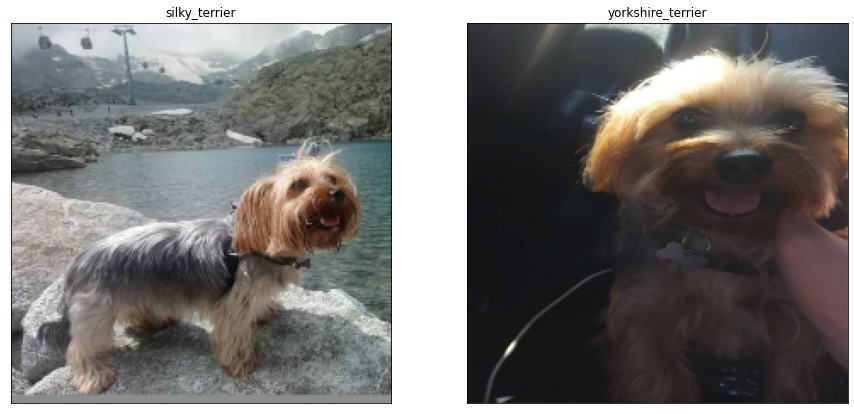

In [ ]:
# Check custom image predictions
plt.figure(figsize=(15, 15))
for i, image in enumerate(custom_images):
  plt.subplot(1, 2, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)